In [1]:
import pandas as pd
import numpy as np
import scipy.stats as stats 
import missingno as mnso
import seaborn as sns
import matplotlib.pyplot as plt

df_test=pd.read_csv('test.csv')
df_train=pd.read_csv('train2.csv')


In [2]:
nan_counts = df_train.isna().sum()
nan_counts

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age              0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly         0
Monthly_Balance                 0
Credit_Score                    0
Payment_Behaviour_Spent         0
Payment_Behaviour_Value         0
dtype: int64

In [3]:
# create a dictionary to map the string values to integer values
score_map = {'Poor': 1, 'Standard': 2, 'Good': 3}

# replace the string values with integer values using the map
df_train['Credit_Score'] = df_train['Credit_Score'].replace(score_map).astype(int)


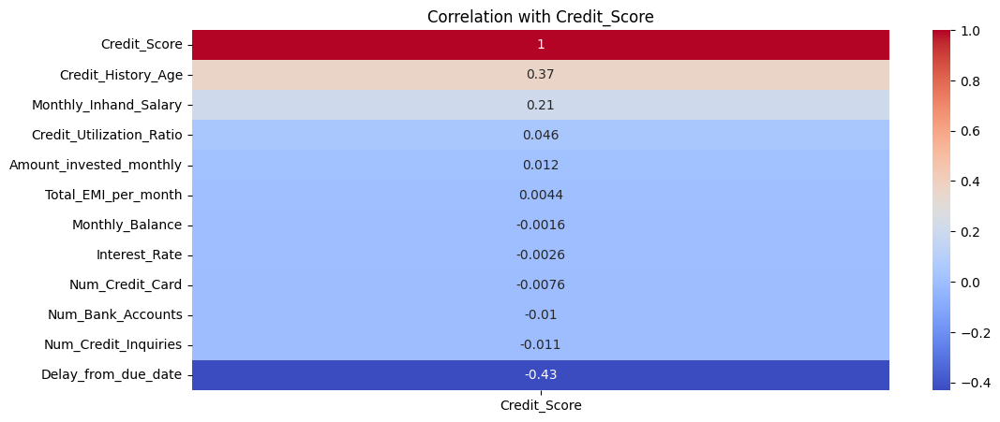

In [4]:
# get only numeric columns
numeric_cols = df_train.select_dtypes(include=np.number).columns.tolist()

corr_df = df_train[numeric_cols].corr()[['Credit_Score']].sort_values('Credit_Score', ascending=False)

fig, ax = plt.subplots(figsize=(12, 5))
sns.heatmap(corr_df, annot=True, cmap='coolwarm', ax=ax)
ax.set_title("Correlation with Credit_Score")
plt.show()

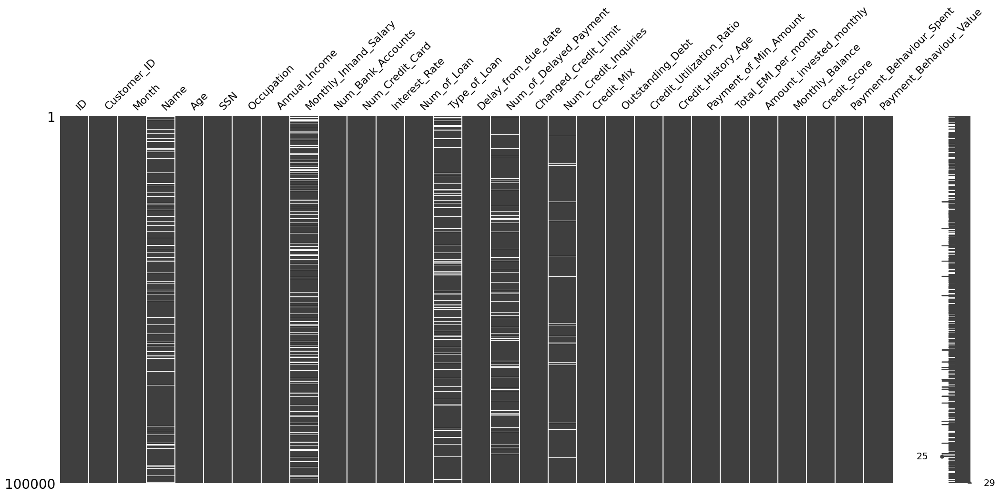

In [5]:
mnso.matrix(df_train)
plt.show()

In [6]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 29 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [7]:
df_train.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Monthly_Balance', 'Credit_Score',
       'Payment_Behaviour_Spent', 'Payment_Behaviour_Value'],
      dtype='object')

                                         ** cleaning the age column**


In [8]:
df_train['Age'] = df_train['Age'].map(lambda x: str(x).strip('_ ,"'))
df_train['Age'] = df_train['Age'].astype('int64')
df_train['Age'].dtypes

dtype('int64')

In [9]:
#calculate the min and max mode: which is the min value that appears most often. and the max too


list_of_ages = df_train.groupby('Customer_ID')['Age'].apply(list)
x, y = list_of_ages.apply(lambda x: stats.mode(x)).apply([min, max])
mini, maxi = x[0][0], y[0][0]

C:\Users\User\AppData\Local\Temp\ipykernel_16200\2580257937.py:5: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  x, y = list_of_ages.apply(lambda x: stats.mode(x)).apply([min, max])


In [10]:
print(df_train[(df_train['Age']<14) | (df_train['Age']>70) ]["Age"].count())

2781


In [11]:
#create a temp column and assign NaN to every value less than 14 or bigger than 56
temp_age_column = df_train['Age'].transform(lambda x: np.NaN if ((x<14)|(x>56)) else x)

In [12]:
# fill the all the ages of each customer ID with the local mode for all values, if its empty then fill it with NaN
mode_by_group = df_train.groupby('Customer_ID')['Age'].transform(lambda x: x.mode()[0] if not x.mode().empty else np.NaN)
result = temp_age_column.fillna(mode_by_group)
df_train['Age']=result
counts =df_train['Month'].value_counts()
counts

Month
January     12500
February    12500
March       12500
April       12500
May         12500
June        12500
July        12500
August      12500
Name: count, dtype: int64

                                check if the occupation needs cleaning

In [13]:
Occupation =df_train['Occupation'].value_counts()
Occupation


Occupation
_______          7062
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64

In [14]:
df_train['Occupation'] = df_train['Occupation'].map(lambda x: str(x).strip('_'))
df_train['Occupation'] = df_train.groupby('Customer_ID')['Occupation'].transform(lambda x: x.mode()[0]) 
Occupation =df_train['Occupation'].value_counts()
Occupation


Occupation
Lawyer           7096
Engineer         6840
Architect        6808
Mechanic         6776
Scientist        6744
Accountant       6744
Developer        6712
Media_Manager    6696
Teacher          6656
Entrepreneur     6648
Doctor           6552
Journalist       6528
Manager          6408
Musician         6328
Writer           6304
                  160
Name: count, dtype: int64

In [15]:
check = df_train[df_train['Occupation'] == 'Unkown']
check  

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,Payment_Behaviour_Spent,Payment_Behaviour_Value


In [16]:
df_train['Occupation'].replace('', 'Unkown', inplace=True)
Occupation =df_train['Occupation'].value_counts()
Occupation

Occupation
Lawyer           7096
Engineer         6840
Architect        6808
Mechanic         6776
Scientist        6744
Accountant       6744
Developer        6712
Media_Manager    6696
Teacher          6656
Entrepreneur     6648
Doctor           6552
Journalist       6528
Manager          6408
Musician         6328
Writer           6304
Unkown            160
Name: count, dtype: int64

In [17]:
df_train['Annual_Income'].info()
df_train['Annual_Income'].describe()
print(df_train['Annual_Income'].min())
print(df_train['Annual_Income'].max())
print(df_train['Annual_Income'].sort_values().head())

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Annual_Income
Non-Null Count   Dtype 
--------------   ----- 
100000 non-null  object
dtypes: object(1)
memory usage: 781.4+ KB
10001727.0
99995.22
93418    10001727.0
25078     10003.495
25076     10003.495
25075     10003.495
25074     10003.495
Name: Annual_Income, dtype: object


In [18]:
df_train['Annual_Income'] = df_train['Annual_Income'].apply(lambda x: x[:-1] if not x[-1].isdigit() else x)
df_train['Annual_Income'] = pd.to_numeric(df_train['Annual_Income'].str.replace('[^\d.]', ''), downcast='integer')


In [19]:
print(df_train['Monthly_Inhand_Salary'].sort_values().head())
print(df_train['Monthly_Inhand_Salary'].max())

83645    303.645417
83647    303.645417
83646    303.645417
83644    303.645417
83643    303.645417
Name: Monthly_Inhand_Salary, dtype: float64
15204.633333333331


In [20]:
# Calculate the correlation coefficient
df_filtered = df_train[df_train['Annual_Income'] < 180000]
corr_coef = df_filtered['Annual_Income'].corr(df_train['Monthly_Inhand_Salary'])

print('Correlation coefficient:', corr_coef)

Correlation coefficient: 0.9981917378223611


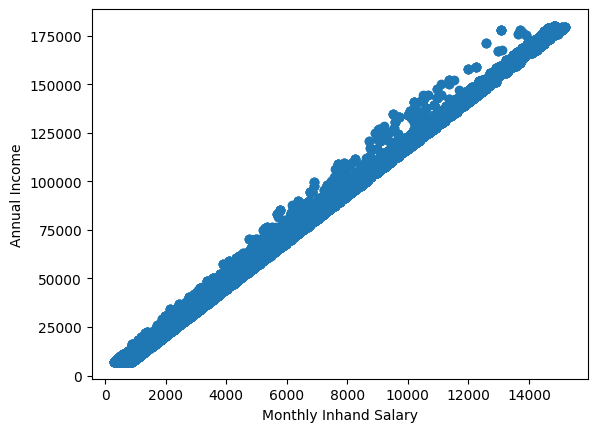

In [21]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter the data for annual incomes less than 100k
df_filtered = df_train[df_train['Annual_Income'] < 180000]

# Plot a scatter plot of Monthly_Inhand_Salary against Annual_Income
plt.scatter(df_filtered['Monthly_Inhand_Salary'], df_filtered['Annual_Income'])
plt.xlabel('Monthly Inhand Salary')
plt.ylabel('Annual Income')
plt.show()

In [22]:
print(df_train['Monthly_Inhand_Salary'].isnull().sum())
print(df_train[df_train['Monthly_Inhand_Salary'].isnull() & (df_train['Annual_Income'] < 180000)]['Annual_Income'])


15002
1        19114.12
2        19114.12
3        19114.12
5        19114.12
11       34847.84
           ...   
99944    59146.36
99955    38321.39
99963    42903.79
99975    16680.35
99978    37188.10
Name: Annual_Income, Length: 14855, dtype: float64


In [23]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split


# Filter the data
df_filtered = df_train[df_train['Annual_Income'] < 180000]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    df_filtered.loc[df_filtered['Monthly_Inhand_Salary'].notnull(), 'Annual_Income'].values.reshape(-1, 1),
    df_filtered.loc[df_filtered['Monthly_Inhand_Salary'].notnull(), 'Monthly_Inhand_Salary'].values.reshape(-1, 1),
    test_size=0.3,
    random_state=42
)

# Train the model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on testing set
y_pred = model.predict(X_test)

# Print evaluation metrics
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print('MSE:', mse)
print('RMSE:', rmse)
print('R2:', r2)

MSE: 36320.81283907548
RMSE: 190.58020054317154
R2: 0.9963847758800946


In [24]:
# Filter the data
df_filtered = df_train[df_train['Annual_Income'] <= 180000]

# Split the data into training and testing sets
X_train = df_train.loc[df_train['Monthly_Inhand_Salary'].notnull() & (df_train['Annual_Income'] <= 180000), 'Annual_Income'].values.reshape(-1, 1)
y_train = df_train.loc[df_train['Monthly_Inhand_Salary'].notnull() & (df_train['Annual_Income'] <= 180000), 'Monthly_Inhand_Salary'].values.reshape(-1, 1)

# Split the data into testing set
X_test = df_train.loc[df_train['Monthly_Inhand_Salary'].isnull() & (df_train['Annual_Income'] <= 180000), 'Annual_Income'].values.reshape(-1, 1)

# Train the model
model = LinearRegression()
model.fit(X_train, y_train)

# Predict the missing values
y_pred = model.predict(X_test)

# Fill the missing values with predicted values
df_train.loc[df_train['Monthly_Inhand_Salary'].isnull() & (df_train['Annual_Income'] <= 180000), 'Monthly_Inhand_Salary'] = y_pred

# Fill the remaining missing values with mean
mean = df_train['Monthly_Inhand_Salary'].mean()
df_train['Monthly_Inhand_Salary'] = df_train['Monthly_Inhand_Salary'].fillna(mean)

print('Monthly_Inhand_Salary null values count:',df_train['Monthly_Inhand_Salary'].isnull().sum())


Monthly_Inhand_Salary null values count: 0


In [25]:
print(df_train['Num_Bank_Accounts'].info())
print(df_train['Num_Bank_Accounts'].describe())
print(df_train['Num_Bank_Accounts'].min())
print(df_train['Num_Bank_Accounts'].max())
print(df_train['Num_Bank_Accounts'].sort_values().head(10000))
print(df_train['Num_Bank_Accounts'].sort_values().tail(10000))


<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Num_Bank_Accounts
Non-Null Count   Dtype
--------------   -----
100000 non-null  int64
dtypes: int64(1)
memory usage: 781.4 KB
None
count    100000.000000
mean         17.091280
std         117.404834
min          -1.000000
25%           3.000000
50%           6.000000
75%           7.000000
max        1798.000000
Name: Num_Bank_Accounts, dtype: float64
-1
1798
30334   -1
30335   -1
47215   -1
47214   -1
47213   -1
        ..
50289    2
50290    2
50291    2
50292    2
50293    2
Name: Num_Bank_Accounts, Length: 10000, dtype: int64
21358       9
21359       9
25688       9
2525        9
20549       9
         ... 
35195    1793
29242    1794
69059    1794
20277    1798
64537    1798
Name: Num_Bank_Accounts, Length: 10000, dtype: int64


In [26]:
import plotly.express as px

fig = px.histogram(df_train, x='Num_Bank_Accounts', nbins=50,
                   template='plotly_dark',
                   title='Distribution of Number of Bank Accounts')
fig.show()




In [27]:
import pandas as pd
import plotly.express as px

bigger10_df = df_train[df_train['Num_Bank_Accounts'] > 12].copy()
equal10_df = df_train[df_train['Num_Bank_Accounts'] == 10].copy()

# Add a "Label" column to each dataset
df_train['Label'] = 'All bank account'
bigger10_df['Label'] = 'Bigger than 12'
equal10_df['Label'] = 'Equal 12'

# Combine the two datasets into one
combined_df = pd.concat([df_train, equal10_df, bigger10_df], ignore_index=True)

# Create the violin plot
fig = px.violin(combined_df, x='Label', y='Credit_Score', color='Label',
                template='plotly_dark', 
                title='Impact of Account numbers Distribution on Credit Score ',width=750)

# Show the plot
fig.show()





In [28]:
# Calculate median value of Num_Bank_Accounts column
median_value = df_train['Num_Bank_Accounts'].median()

# Replace the values in the specified rows with median value
df_train.loc[df_train['Num_Bank_Accounts'] > 12, 'Num_Bank_Accounts'] = median_value
df_train[df_train['Num_Bank_Accounts'] > 12]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,Payment_Behaviour_Spent,Payment_Behaviour_Value,Label


In [29]:

print(df_train['Num_Credit_Card'].info())
print(df_train['Num_Credit_Card'].describe())
print(df_train['Num_Credit_Card'].min())
print(df_train['Num_Credit_Card'].max())
print(df_train['Num_Credit_Card'].sort_values().tail(1000))

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Num_Credit_Card
Non-Null Count   Dtype
--------------   -----
100000 non-null  int64
dtypes: int64(1)
memory usage: 781.4 KB
None
count    100000.00000
mean         22.47443
std         129.05741
min           0.00000
25%           4.00000
50%           5.00000
75%           7.00000
max        1499.00000
Name: Num_Credit_Card, dtype: float64
0
1499
57672     849
94898     849
94436     849
65264     849
77070     849
         ... 
77711    1498
18343    1498
62075    1498
25015    1499
72123    1499
Name: Num_Credit_Card, Length: 1000, dtype: int64


In [30]:
import plotly.express as px

fig = px.histogram(df_train, x='Num_Credit_Card', nbins=50,
                   template='plotly_dark',
                   title='Distribution of Number of Credit Cards')
fig.show()

In [31]:
import pandas as pd
import plotly.express as px

bigger10_df = df_train[df_train['Num_Credit_Card'] >12].copy()
equal12_df = df_train[df_train['Num_Credit_Card'] == 10].copy()

# Add a "Label" column to each dataset
df_train['Label'] = 'All bank account'
bigger10_df['Label'] = 'Bigger than 12'
equal12_df['Label'] = 'Equal 12'

# Combine the two datasets into one
combined_df = pd.concat([df_train,equal12_df, bigger10_df], ignore_index=True)

# Create the violin plot
fig = px.violin(combined_df, x='Label', y='Credit_Score', color='Label',
                template='plotly_dark', 
                title='Impact of Account numbers Distribution on Credit Score ',width=1200)

# Show the plot
fig.show()



In [32]:
# Calculate median value of Num_Bank_Accounts column
median_value = df_train['Num_Credit_Card'].median()


# Replace the values in the specified rows with median value
df_train.loc[df_train['Num_Credit_Card'] > 12, 'Num_Credit_Card'] = median_value
df_train[df_train['Num_Credit_Card'] > 12]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,Payment_Behaviour_Spent,Payment_Behaviour_Value,Label


In [33]:

print(df_train['Interest_Rate'].info())
print(df_train['Interest_Rate'].describe())
print(df_train['Interest_Rate'].min())
print(df_train['Interest_Rate'].max())
print(df_train['Interest_Rate'].sort_values().tail(2000))

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Interest_Rate
Non-Null Count   Dtype
--------------   -----
100000 non-null  int64
dtypes: int64(1)
memory usage: 781.4 KB
None
count    100000.000000
mean         72.466040
std         466.422621
min           1.000000
25%           8.000000
50%          13.000000
75%          20.000000
max        5797.000000
Name: Interest_Rate, dtype: float64
1
5797
40109     136
91544     137
26737     140
14186     142
58772     144
         ... 
77710    5775
88505    5776
23512    5788
73583    5789
71641    5797
Name: Interest_Rate, Length: 2000, dtype: int64


In [34]:
import plotly.express as px

# Filter the dataframe to include only rows where Interest_Rate is greater than 34
df_filtered = df_train[df_train['Interest_Rate'] > 34]

# Create a histogram of the filtered data
fig = px.histogram(df_filtered, x='Interest_Rate', nbins=50,
                   template='plotly_dark',
                   title='Distribution of Number of Credit Cards with Interest Rate > 30',width=950)
fig.show()
num_values_bigger_than_34 = df_train[df_train['Interest_Rate'] > 34]['Interest_Rate'].count()
print(num_values_bigger_than_34)

2034


In [35]:
import pandas as pd
import plotly.express as px

bigger34_df = df_train[df_train['Interest_Rate'] > 34].copy()
equal34_df = df_train[df_train['Interest_Rate'] == 34].copy()

# Add a "Label" column to each dataset
df_train['Label'] = 'All bank account'
bigger34_df['Label'] = 'Bigger than 34'
equal34_df['Label'] = 'Interest rate equal to 34'

# Combine the datasets into one
combined_df = pd.concat([df_train, equal34_df, bigger34_df ], ignore_index=True)

# Create the violin plot
fig = px.violin(combined_df, x='Label', y='Credit_Score', color='Label',
                template='plotly_dark', 
                title='Impact of Interest Rate Distribution on Credit Score ',width=750)

# Show the plot
fig.show()


In [36]:
# Calculate median value of Num_Bank_Accounts column
median_value = df_train['Interest_Rate'].median()


# Replace the values in the specified rows with median value
df_train.loc[df_train['Interest_Rate'] > 34, 'Interest_Rate'] = median_value
df_train[df_train['Interest_Rate'] > 34]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,Payment_Behaviour_Spent,Payment_Behaviour_Value,Label


In [37]:
print(df_train['Num_of_Loan'].info())
print(df_train['Num_of_Loan'].describe())
print(df_train['Num_of_Loan'].min())
print(df_train['Num_of_Loan'].max())
print(df_train['Num_of_Loan'].sort_values().tail(50))

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Num_of_Loan
Non-Null Count   Dtype 
--------------   ----- 
100000 non-null  object
dtypes: object(1)
memory usage: 781.4+ KB
None
count     100000
unique       434
top            3
freq       14386
Name: Num_of_Loan, dtype: object
-100
9_
59049    9_
32571    9_
16833    9_
73758    9_
23602    9_
10853    9_
42905    9_
10862    9_
391      9_
18190    9_
23459    9_
23457    9_
56590    9_
47704    9_
22013    9_
78897    9_
18747    9_
72482    9_
86460    9_
82063    9_
79644    9_
70380    9_
65360    9_
70376    9_
91617    9_
91618    9_
79641    9_
91621    9_
68060    9_
3353     9_
52182    9_
19107    9_
21802    9_
70283    9_
40307    9_
10399    9_
43397    9_
37534    9_
13213    9_
28543    9_
8125     9_
32512    9_
54127    9_
26669    9_
89777    9_
97773    9_
21777    9_
32523    9_
4907     9_
17302    9_
Name: Num_of_Loan, dtype: object


In [38]:
df_train['Num_of_Loan'] = df_train['Num_of_Loan'].apply(lambda x: x[:-1] if not x[-1].isdigit() else x)

In [39]:
# Assuming the column name is 'Num_of_Loan'
num_loan = df_train['Num_of_Loan']

# Convert to numeric
num_loan_numeric = pd.to_numeric(num_loan, errors='coerce')

df_train['Num_of_Loan'] = pd.to_numeric(df_train['Num_of_Loan'], errors='coerce')


# Check how many rows are numeric
print('Number of numeric rows:', num_loan_numeric.notnull().sum())

print(df_train['Num_of_Loan'].describe())



Number of numeric rows: 100000
count    100000.000000
mean          3.009960
std          62.647879
min        -100.000000
25%           1.000000
50%           3.000000
75%           5.000000
max        1496.000000
Name: Num_of_Loan, dtype: float64


In [40]:
import plotly.express as px

# Filter the dataframe to include only rows where Interest_Rate is greater than 9
df_filtered = df_train[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0)]


# Create a histogram of the filtered data
fig = px.histogram(df_filtered, x='Num_of_Loan', nbins=50,
                   template='plotly_dark',
                   title='Distribution of Number of Credit Cards with Nummer of Loan > 9 and Nummer of Loan < 0  ',width=750)
fig.show()
num_values_bigger_than_9 = df_train[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0)]['Num_of_Loan'].count()
print(num_values_bigger_than_9)

4348


In [41]:
import pandas as pd
import plotly.express as px

bigger10_df = df_train[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0)].copy()
equal1_df = df_train[(df_train['Num_of_Loan'] <0)].copy()
equal9_df = df_train[(df_train['Num_of_Loan'] ==9)].copy()

# Add a "Label" column to each dataset
df_train['Label'] = 'All bank account'
bigger10_df['Label'] = 'Bigger than 9 and lower then 0'
equal1_df['Label'] = 'lower than 0'
equal9_df['Label'] = 'Equal 9'

# Combine the two datasets into one
combined_df = pd.concat([df_train, equal1_df,equal9_df, bigger10_df], ignore_index=True)

# Create the violin plot
fig = px.violin(combined_df, x='Label', y='Credit_Score', color='Label',
                template='plotly_dark', 
                title='Impact of Loan number Distribution on Credit Score ',width=750)

# Show the plot
fig.show()

In [141]:
df_train[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0)]['Type_of_Loan']


21                 Auto Loan, Auto Loan, and Not Specified
31                                           Not Specified
34                                                     NaN
39                                                     NaN
53                  Credit-Builder Loan, and Mortgage Loan
                               ...                        
99901                                        Not Specified
99902                                        Not Specified
99919    Home Equity Loan, Payday Loan, Not Specified, ...
99969    Payday Loan, Student Loan, Mortgage Loan, and ...
99987    Personal Loan, Auto Loan, Mortgage Loan, Stude...
Name: Type_of_Loan, Length: 4348, dtype: object

In [142]:
print(df_train['Type_of_Loan'].info())
print(df_train['Type_of_Loan'].describe())
print('Sum of nan values:',df_train['Type_of_Loan'].isnull().sum())
freq_table = df_train['Type_of_Loan'].value_counts()
print(freq_table.tail(20))

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Type_of_Loan
Non-Null Count  Dtype 
--------------  ----- 
88592 non-null  object
dtypes: object(1)
memory usage: 781.4+ KB
None
count             88592
unique             6260
top       Not Specified
freq               1408
Name: Type_of_Loan, dtype: object
Sum of nan values: 11408
Type_of_Loan
Home Equity Loan, Payday Loan, Credit-Builder Loan, Auto Loan, and Payday Loan                                                                  8
Debt Consolidation Loan, Personal Loan, Mortgage Loan, Personal Loan, Not Specified, Mortgage Loan, and Home Equity Loan                        8
Auto Loan, Credit-Builder Loan, Student Loan, and Student Loan                                                                                  8
Personal Loan, Student Loan, Not Specified, Debt Consolidation Loan, and Student Loan                                                           8
Mortgage Loan, Credit-Builder L

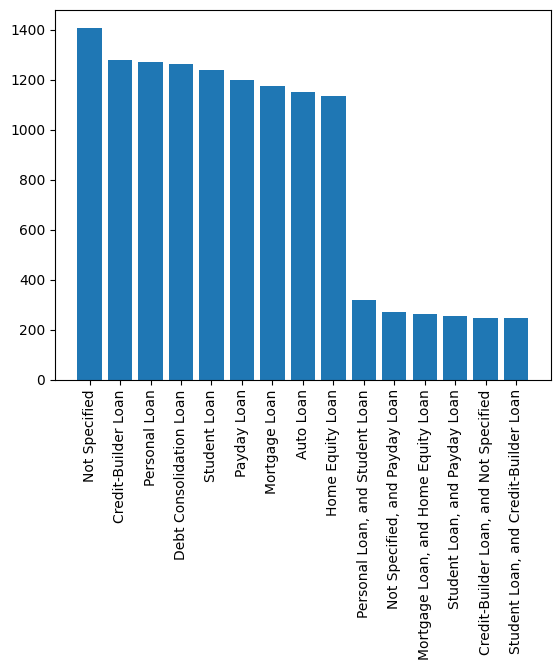

In [143]:
value_counts = df_train['Type_of_Loan'].value_counts()
value_counts_filtered = value_counts[value_counts > 240]

plt.bar(value_counts_filtered.index, value_counts_filtered.values)
plt.xticks(rotation=90)
plt.show()

In [144]:
value=df_train['Num_of_Loan'].median()
df_train['Type_of_Loan'] = df_train['Type_of_Loan'].fillna(value)

# Count number of elements separated by comma
num_elements = df_train['Type_of_Loan'].astype(str).apply(lambda x: x.count(',') + 1 if x!= 'Not Specified'  else 0)

# Create new column
df_train = df_train.assign(Num_of_Loan_Types=num_elements)

# Replace the values in the specified rows with Num_of_Loan_Types cloumn value
df_train.loc[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0), 'Num_of_Loan'] = df_train['Num_of_Loan_Types']
print(df_train[(df_train['Num_of_Loan'] > 9) | (df_train['Num_of_Loan'] < 0)])


# Check the correlation between the two columns
corr = df_train['Num_of_Loan'].corr(df_train['Num_of_Loan_Types'])

print('Correlation between Num_of_Loan and Num_of_Loan_Types_int:', corr)
df_train['Num_of_Loan'].describe()

Empty DataFrame
Columns: [ID, Customer_ID, Month, Name, Age, SSN, Occupation, Annual_Income, Monthly_Inhand_Salary, Num_Bank_Accounts, Num_Credit_Card, Interest_Rate, Num_of_Loan, Type_of_Loan, Delay_from_due_date, Num_of_Delayed_Payment, Changed_Credit_Limit, Num_Credit_Inquiries, Credit_Mix, Outstanding_Debt, Credit_Utilization_Ratio, Credit_History_Age, Payment_of_Min_Amount, Total_EMI_per_month, Amount_invested_monthly, Monthly_Balance, Credit_Score, Payment_Behaviour_Spent, Payment_Behaviour_Value, Label, Num_of_Loan_Types]
Index: []

[0 rows x 31 columns]
Correlation between Num_of_Loan and Num_of_Loan_Types_int: 0.9913333441480534


count    100000.000000
mean          3.536980
std           2.441264
min           0.000000
25%           2.000000
50%           3.000000
75%           5.000000
max           9.000000
Name: Num_of_Loan, dtype: float64

<br>
<br>
<br>

# Juan Part

In [145]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

print('setup')

setup


In [146]:
print(df_train["Credit_Mix"].unique())
print(df_train.groupby("Credit_Mix")['Credit_Score'].mean())
df_train[df_train["Credit_Mix"]=='_']["Credit_Mix"].count()

['_' 'Good' 'Standard' 'Bad']
Credit_Mix
Bad         1.414345
Good        2.329293
Standard    1.840566
_           1.888735
Name: Credit_Score, dtype: float64


20195

In [147]:
# create a dictionary to map the string values to integer values
score_map = {'Bad': 0, 'Standard': 1, '_':2, 'Good': 3}

# replace the string values with integer values using the map
df_train['Credit_Mix'] = df_train['Credit_Mix'].replace(score_map)
print(df_train['Credit_Mix'].dtypes)
df_train['Credit_Mix'].unique()

int64


array([2, 3, 1, 0], dtype=int64)

In [148]:
df = df_train[['Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt',
       'Credit_Utilization_Ratio']]

def dirty_data(df):
    dirty = []
    columns = df.columns
    for col in columns:
        dtype = df[col].dtypes
        nunique = df[col].nunique()
        null = df[col].isnull().sum()
        duplicates = df[col].duplicated().sum()
        dirty.append([col,dtype,nunique,null,duplicates])
    df_dirty_data_finding = pd.DataFrame(dirty)
    df_dirty_data_finding.columns = ['column','dtype','nunique','null','duplicates']
    return df_dirty_data_finding

def cleaning_Null_columns(df_column):
  df_column.fillna(-99999, inplace = True)
  return df_column.value_counts(dropna = False)

def fix_nums(num):
    try : 
        return float(num.replace("_",""))
    except :
        return np.NaN
 

        
def plot_boxplots(df, ncols=3, color="", figsize=(10, 10)):
    try :
        # Calculate number of rows and columns
        nrows = (len(df.columns) - 1) // ncols + 1
        
        # Create figure and subplots
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
        
        # Loop through columns and plot boxplot
        for i, column in enumerate(df.columns):
            ax = axes.flat[i]
            sns.boxplot(df[column], ax=ax, color=color, whis=1.5, saturation=0.5, width=0.5, orient='h', notch=True, showcaps=False)
            ax.axvline(df[column].median(), color='r', linestyle='--')
            ax.set_title(column)
            ax.legend([f'Median: {df[column].median():.2f}'], loc='best')
        
        for ax in axes.flat:
            ax.grid(True)
        
        # Remove any unused axes
        if len(df.columns) % ncols != 0:
            for i in range(len(df.columns) % ncols, ncols):
                fig.delaxes(axes.flat[-i])
        
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error: {e}")
        
        
def process_column(df_column):
    try:
        # Calculate the 95 percentile
        q95 = df_test[df_column.name].quantile(0.95)

        # Replace values above the 95 percentile with the median value
        df_test_test = df_test[df_test[df_column.name] <= q95][df_column.name]
        median_col = int(df_test_test.median())

        df_test.loc[df_test[df_column.name] > q95, df_column.name] = median_col
        df_test.loc[df_test[df_column.name] == -99999, df_column.name] = median_col  
        
    except Exception as e:
        print(f"Error: {e}")      


def df_process_data(df):
    try:
        processed = []
        columns = df.columns
        for col in columns:
            # Check for outliers and replace with median
            q95 = df[col].quantile(0.95).round(1)
            df_test = df[df[col] <= q95][col]
            median_col = int(df_test.median())
            df.loc[df[col] > q95, col] = median_col
            df.loc[df[col] == -99999, col] = median_col
            processed.append([col,q95,median_col])
        df_processed_data_finding = pd.DataFrame(processed, columns=['column','quantile95','median_col'])
        return df_processed_data_finding
    except Exception as e:
        print(f"Error: {e}")

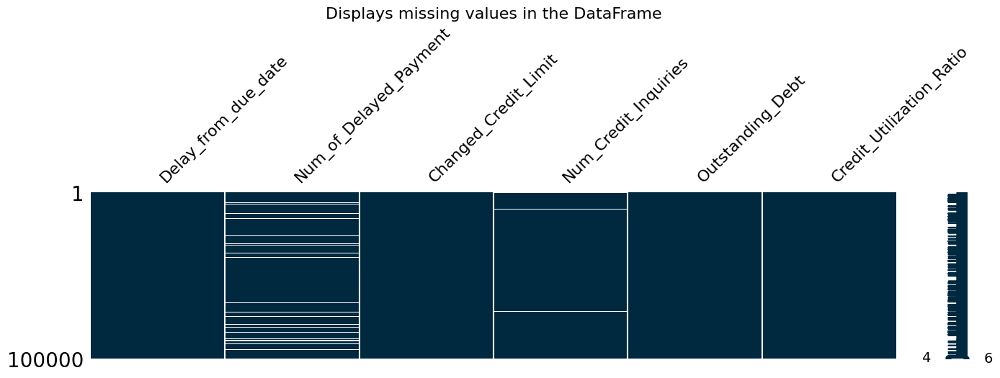

,column,dtype,nunique,null,duplicates
0,Delay_from_due_date,int64,73,0,99927
1,Num_of_Delayed_Payment,object,749,7002,99250
2,Changed_Credit_Limit,object,4384,0,95616
3,Num_Credit_Inquiries,float64,1223,1965,98776
4,Outstanding_Debt,object,13178,0,86822
5,Credit_Utilization_Ratio,float64,100000,0,0


In [149]:
import missingno as msno

msno.matrix(df, figsize=(16, 3), color = (0.0, 0.16, 0.25))
plt.title('Displays missing values in the DataFrame', fontsize=16)
plt.show()

dirty_data(df)

In [150]:
# df_train['Credit_Mix'] = pd.factorize(df_train['Credit_Mix'], sort=True)[0]
# df_train['Credit_Mix'] = df_train['Credit_Mix'].astype(int)

num_to_fix = ['Num_of_Delayed_Payment', 'Changed_Credit_Limit','Outstanding_Debt']

for col in num_to_fix :
    df_train[col] = df_train[col].apply(fix_nums)
    
cleaning_Null_columns(df_train['Num_of_Delayed_Payment'])
cleaning_Null_columns(df_train['Changed_Credit_Limit'])
cleaning_Null_columns(df_train['Num_Credit_Inquiries'])
# dirty_df_test_finding(df)

df = df_train[['Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt',
       'Credit_Utilization_Ratio']]

dirty_data(df)



,column,dtype,nunique,null,duplicates
0,Delay_from_due_date,int64,73,0,99927
1,Num_of_Delayed_Payment,float64,712,0,99288
2,Changed_Credit_Limit,float64,4384,0,95616
3,Num_Credit_Inquiries,float64,1224,0,98776
4,Outstanding_Debt,float64,12203,0,87797
5,Credit_Utilization_Ratio,float64,100000,0,0


<br>
<br>

# EDA (Box plot)

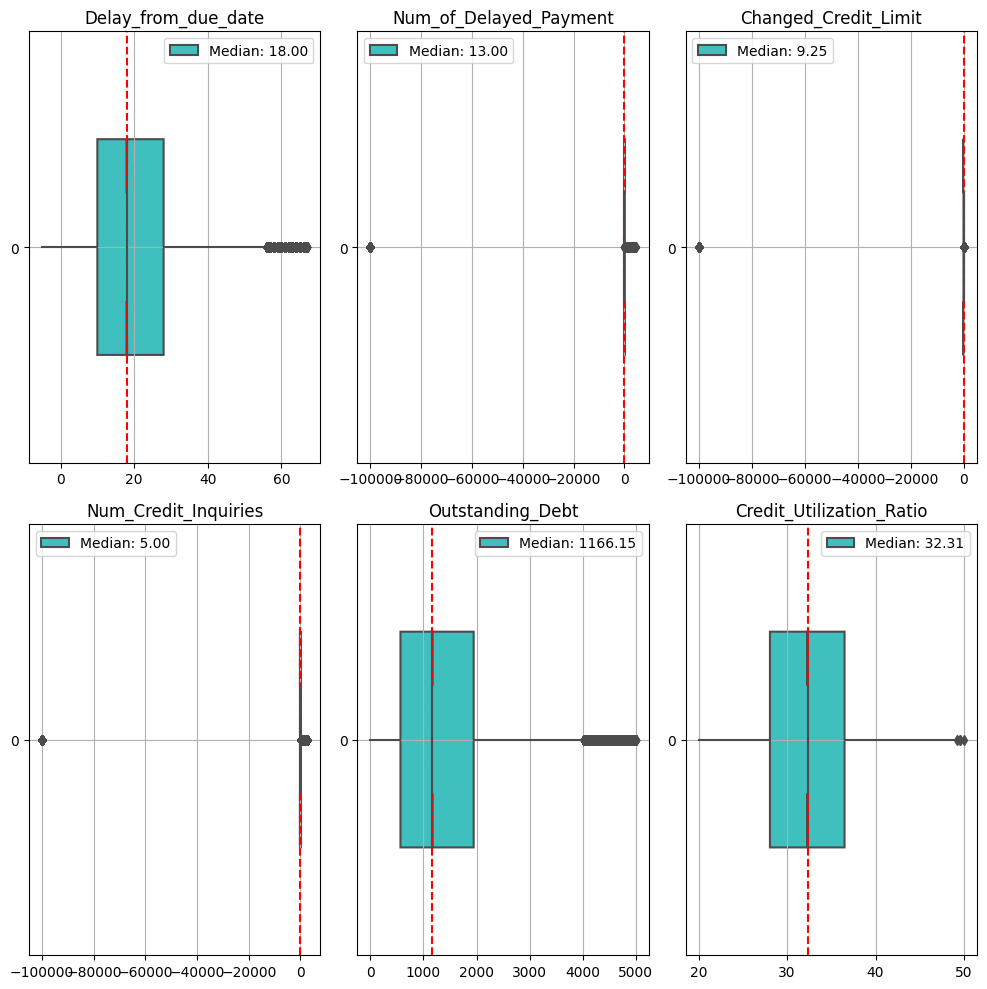

In [151]:
plot_boxplots(df,  ncols=3, color='cyan')

In [152]:
df.apply(process_column)
df_process_data(df)

Error: unsupported operand type(s) for -: 'str' and 'str'
Error: unsupported operand type(s) for -: 'str' and 'str'
Error: unsupported operand type(s) for -: 'str' and 'str'


,column,quantile95,median_col
0,Delay_from_due_date,54.0,17
1,Num_of_Delayed_Payment,23.0,12
2,Changed_Credit_Limit,23.5,8
3,Num_Credit_Inquiries,13.0,5
4,Outstanding_Debt,4073.8,1103
5,Credit_Utilization_Ratio,40.2,31


In [153]:
list_a=['Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt',
       'Credit_Utilization_Ratio']

for i in list_a:
    df_train[i]=df[i]
    median=df_train[i].median()
    df_train[df_train[i]<0][i]=median


C:\Users\User\AppData\Local\Temp\ipykernel_8732\2844320683.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\User\AppData\Local\Temp\ipykernel_8732\2844320683.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\User\AppData\Local\Temp\ipykernel_8732\2844320683.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

In [154]:
df_train["Credit_Score"].unique()

array([3, 2, 1])

<br>

## Processed data (Box plot) 

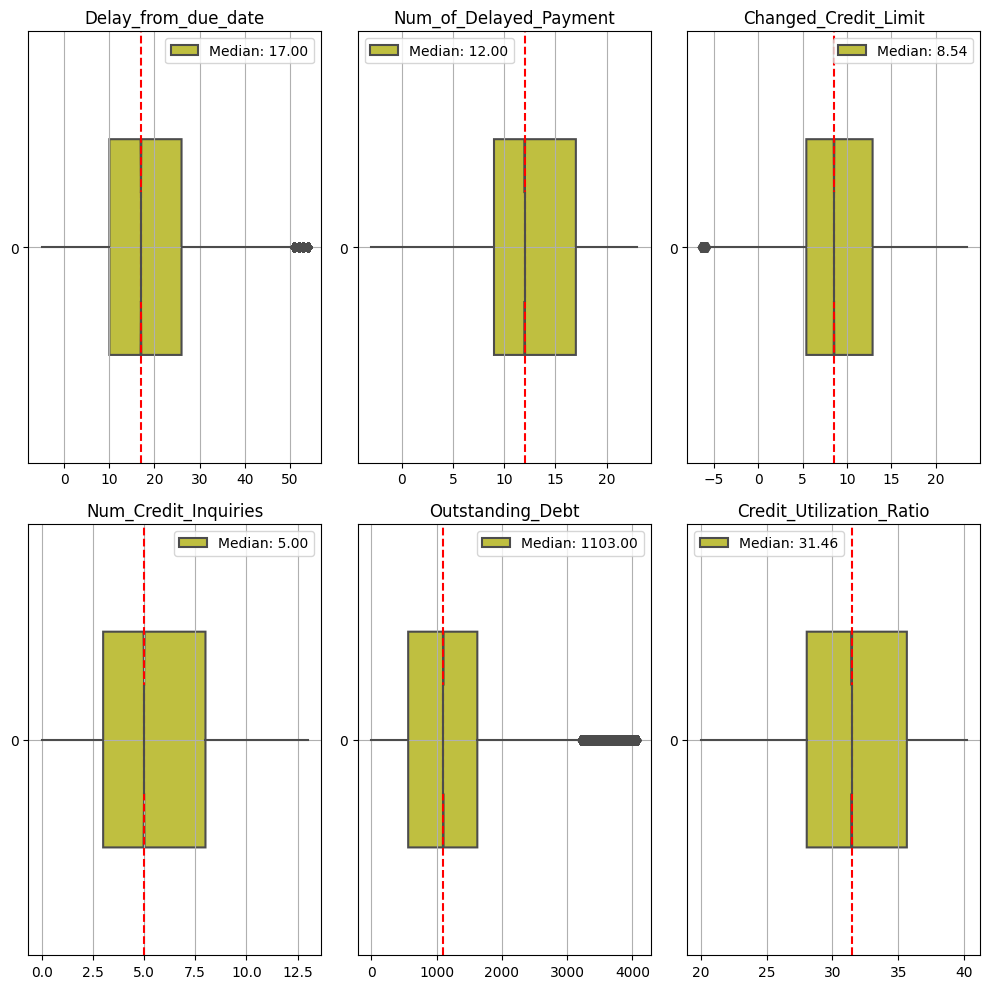

In [155]:
plot_boxplots(df,  ncols=3, color='yellow')

RUMEYSA PART

In [156]:
# # Credit_History_Age : A = years and B = months => 12 * A + B
# def convert_credit_history_age(history_age):
#     if str(history_age) == 'nan':
#         return 'nan'
#     else:
#         years = int(history_age.split(' ')[0])
#         months = int(history_age.split(' ')[3])
#         return 12 * years + months

In [157]:
# # Payment_Behaviour : split into 'spent' and 'value'
# def convert_payment_behaviour(behaviour, split_name):
#     try:
#         if split_name == 'spent':
#             return behaviour.split('_')[0]
#         elif split_name == 'value':
#             return behaviour.split('_')[2]
#         else:
#             return 'nan'
#     except:
#         return 'nan'

In [158]:
# # convert columns
# for data in [df_train]:
    
#     data['Credit_History_Age'] = data['Credit_History_Age'].apply(
#         lambda x: convert_credit_history_age(x)
#     )
#     data['Payment_Behaviour_Spent'] = data['Payment_Behaviour'].apply(
#         lambda x: convert_payment_behaviour(x, 'spent')
#     )
#     data['Payment_Behaviour_Value'] = data['Payment_Behaviour'].apply(
#         lambda x: convert_payment_behaviour(x, 'value')
#     )
    
    
# df_train = df_train.drop(columns=['Payment_Behaviour'])


In [159]:
# # Fix error values in some numeric columns
# def convert_to_int(string):
#     try:
#         return int(str(string).replace('_', ''))
#     except:
#         return 'nan'
    
# def convert_to_float(string):
#     try:
#         return float(str(string).replace('_', ''))
#     except:
#         return 'nan'

In [160]:
# # int/float : for how to remove '_'
# # fixed/var : for how to replace error values (using replacing with same-customer-indicating values or not)
# float_fixed = ['Total_EMI_per_month']
# float_var = ['Amount_invested_monthly', 'Monthly_Balance']

# # remove '_' to convert to int or float
# for data in [df_train]:
#     float_col_with_str = float_fixed + float_var
#     for float_col in float_col_with_str:
#         data[float_col] = data[float_col].apply(lambda x: convert_to_float(x))

In [161]:
# # Amount_invested_monthly, Monthly_Balance -> Fill null (None / NaN) values with median 

# # Amount_invested_monthly : NaN -> str(NaN)
# for col in ['Amount_invested_monthly', 'Monthly_Balance']:
    
#     df_train[col] = df_train[col].apply(
#         lambda x: x if (pd.notnull(x) and convert_to_float(x) != 'nan') else 'NaN_float'
#     )


In [162]:
# def count_null_values(null_values, df_train, test_data):
#     print('training data')
#     for column in null_values.keys():
#         value_counts_train = df_train[column].value_counts()

#         if null_values[column] in value_counts_train:
#             print('null values (' + null_values[column] + ') in column [' + column + '] : ' + str(value_counts_train[null_values[column]]))
#         else:
#             print('null values (' + null_values[column] + ') in column [' + column + '] : 0')
        
#     print('\ntest data')
#     for column in null_values.keys():
#         value_counts_test  = test_data[column].value_counts()

#         if null_values[column] in value_counts_test:
#             print('null values (' + null_values[column] + ') in column [' + column + '] : ' + str(value_counts_test[null_values[column]]))
#         else:
#             print('null values (' + null_values[column] + ') in column [' + column + '] : 0')
# null_values = {
#     'Amount_invested_monthly': 'NaN_float', 'Monthly_Balance': 'NaN_float',
#     'Credit_History_Age': 'nan', 'Payment_Behaviour_Value': 'nan',
#     'Payment_Behaviour_Spent': '!@9#%8'
# }

# count_null_values(null_values, df_train)

In [163]:
# # fill with the median of the same customer
# def replace_with_median(value, idx, data_arr, rows_per_customer, null_value, is_round = False):
#     if value != null_value:
#         return value
    
#     start_idx = (idx // rows_per_customer) * rows_per_customer
#     end_idx = (idx // rows_per_customer + 1) * rows_per_customer
#     data_range = data_arr[start_idx:end_idx]
    
#     values = []
#     fraction = -1
#     for data_value in data_range:
#         if data_value != null_value:
#             values.append(float(data_value))
#             fraction = float(data_value) % 1.0
    
#     if len(values) == 0:
#         return null_value
#     else:
#         result = np.median(values)
        
#         if is_round:
#             return result if abs(result % 1.0 - fraction) < 0.25 else result + 0.5
#         else:
#             return result

In [164]:
# for null_value_col in ['Amount_invested_monthly', 'Monthly_Balance']:
    
#     df_train_np = []
#     test_data_np  = []

#     len_Train = len(df_train)
   

#     for i in range(len_Train):
#         df_train_np.append(
#             replace_with_median(
#                 df_train[null_value_col].iloc[i], i, df_train[null_value_col], 8, null_values[null_value_col]
#             )
#         )

    
#     df_train[null_value_col] = pd.Series(df_train_np)
   

In [165]:
# def fill_month_count_column(value, idx, data_arr, rows_per_customer, null_value):
    
#     # Normal values that are not null are treated as is.
#     if value != null_value:
#         return value
    
#     start_idx = (idx // rows_per_customer) * rows_per_customer
#     end_idx = (idx // rows_per_customer + 1) * rows_per_customer
#     data_range = data_arr[start_idx:end_idx]

#     # For the same customer, as in [300, 301, 302, 303, 304, 305, 306, 307], 
#     # the value increases by 1 whenever the index increases by 1
#     first_valid_value = None
#     for value_idx in range(rows_per_customer):
#         if data_arr[value_idx] != null_value:
#             first_valid_value = [value_idx - start_idx, data_arr[value_idx]]
#             break
#     if first_valid_value == None:
#         return null_value
#     else:
#         return first_valid_value[1] + (idx % rows_per_customer)
# # Fill in null values for the Credit_History_Age column 
# # using other records from the same customer
# df_train_np = []
# test_data_np  = []
# col = 'Credit_History_Age'
    
# for i in range(len_Train):
#     df_train_np.append(
#         fill_month_count_column(df_train[col].iloc[i], i, df_train[col], 8, null_values[col])
#     )
    

    
# df_train[col] = pd.Series(df_train_np)


In [166]:
# # In order to process Payment_Behaviour_Spent and Payment_Behaviour_Value columns, 
# # the number of High and Low values in training and test data is first identified.
# # pb = payment behaviour
# train_pb_spent = df_train['Payment_Behaviour_Spent'].value_counts()
# train_pb_value = df_train['Payment_Behaviour_Value'].value_counts()

# print('Payment-Behaviour-Spent in train data :', train_pb_spent)
# print('\nPayment-Behaviour-Value in train data :', train_pb_value)


In [167]:
# # Payment_Behaviour_Spent: If there are more lows or the same frequency of occurrence among the records of the same customer, it is treated as low, and if there are more highs, it is treated as high.
# # Payment_Behaviour_Value: Processed as the highest among the records of the same customer, but if there are items with the same frequency of occurrence, they are processed in order of Small, Medium, and Large.

# # Function to fill categorical column
# def fill_categorical_column(value, idx, data_arr, rows_per_customer, null_value, pb_count):

#     # Normal values that are not null are treated as is.
#     if value != null_value:
#         return value
    
#     start_idx = (idx // rows_per_customer) * rows_per_customer
#     end_idx = (idx // rows_per_customer +1) * rows_per_customer
#     data_range = data_arr[start_idx:end_idx]

#     pb_count_copied = pb_count.copy()
#     for data_value in data_range:
#         pb_count_copied[data_value][1] += 1

#     # Priority: Number of appearances by the same customer > Sort by number of appearances
#     is_all_null = True
#     pb_count_list_customer = []
    
#     for cnt_key, cnt_value in pb_count_copied.items():
#         pb_count_list_customer.append([cnt_key, cnt_value[0], cnt_value[1]])
#         if cnt_key != null_value and cnt_value[1] > 0:
#             is_all_null = False

#     pb_count_list_customer.sort(key = lambda x: x[1], reverse = True) 
#     pb_count_list_customer.sort(key = lambda x: x[2], reverse = True)

#     if is_all_null:
#         return null_value
#     else:
#         return pb_count_list_customer[0][0] # The most frequent value for that customer according to the priority you have sorted
    
# # Fill in null values for the Payment_Behaviour_Spent column using other records for the same customer
# cols_to_pb_count = {'Payment_Behaviour_Spent': train_pb_spent, 'Payment_Behaviour_Value': train_pb_value}
# for col, pb_count in cols_to_pb_count.items():
#     df_train_np = []
#     test_data_np  = []

#     pb_count_dict = {}
#     for val, cnt in pb_count.items():
#         pb_count_dict[val] = [cnt, 0]

#     print('count of column ' + col + ': ', pb_count_dict)

#     #  Fill in null values
#     for i in range(len_Train):
#         df_train_np.append(
#             fill_categorical_column(df_train[col].iloc[i], i, df_train[col], 8, null_values[col], pb_count_dict)
#         )

#     df_train[col] = pd.Series(df_train_np)
    

In [168]:
# count_null_values(null_values, df_train)

In [169]:
# # There are some null values in monthly_balance
# # Apply median value of all data
# for median_col in ['Monthly_Balance']:
#     arr_train = np.array(df_train[median_col])
#     median_train = np.median(arr_train[arr_train != null_values[median_col]])

#     print('median of [' + median_col + '] :', median_train)

#     for data in [df_train]:
#         data[median_col] = data[median_col].apply(lambda x: median_train if x == null_values[median_col] else x)

In [170]:
# count_null_values(null_values, df_train)

In [171]:
# create a dictionary to map the string values to integer values
score_map = {'No': 2, 'NM': 1, 'Yes': 0}

# replace the string values with integer values using the map
df_train['Payment_of_Min_Amount'] = df_train['Payment_of_Min_Amount'].replace(score_map)
print(df_train['Payment_of_Min_Amount'].dtypes)

int64


In [172]:
# create a dictionary to map the string values to integer values
score_map = {'High': 1, 'Low': 0}

# replace the string values with integer values using the map
df_train['Payment_Behaviour_Spent'] = df_train['Payment_Behaviour_Spent'].replace(score_map)
print(df_train['Payment_Behaviour_Spent'].dtypes)

int64


In [173]:
# create a dictionary to map the string values to integer values
score_map = {'Small': 0, 'Medium': 1, 'Large': 2}

# replace the string values with integer values using the map
df_train['Payment_Behaviour_Value'] = df_train['Payment_Behaviour_Value'].replace(score_map)
print(df_train['Payment_Behaviour_Value'].dtypes)

int64


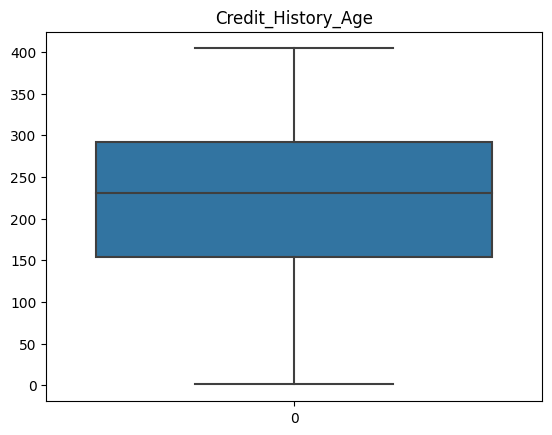

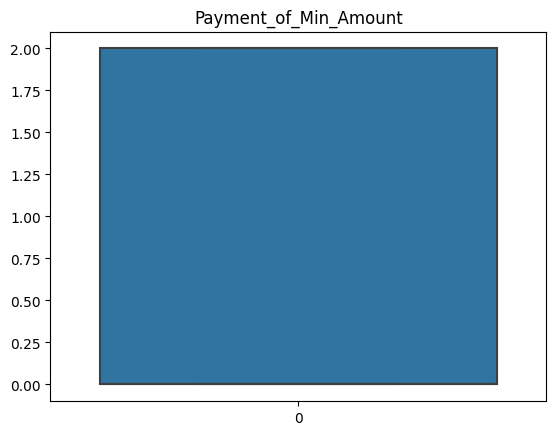

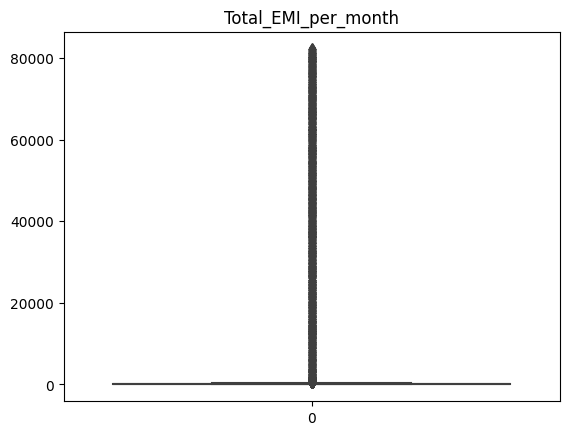

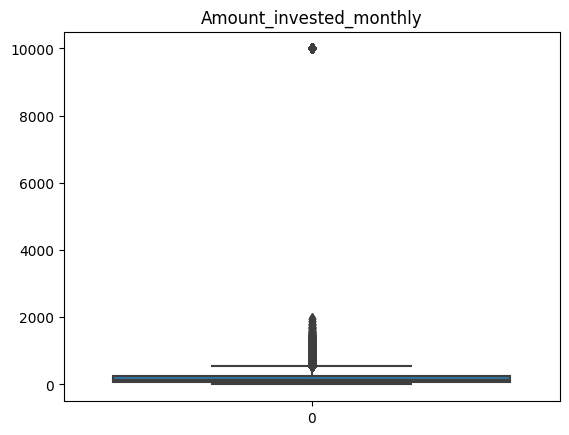

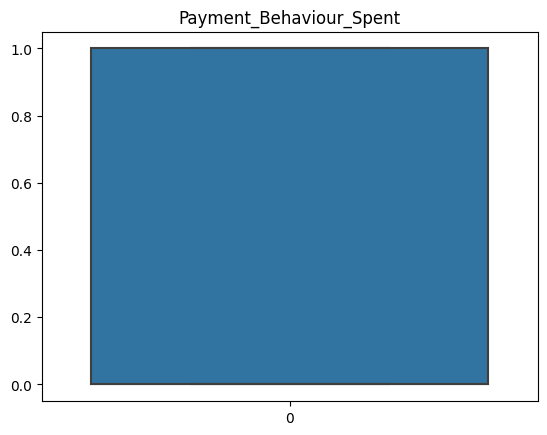

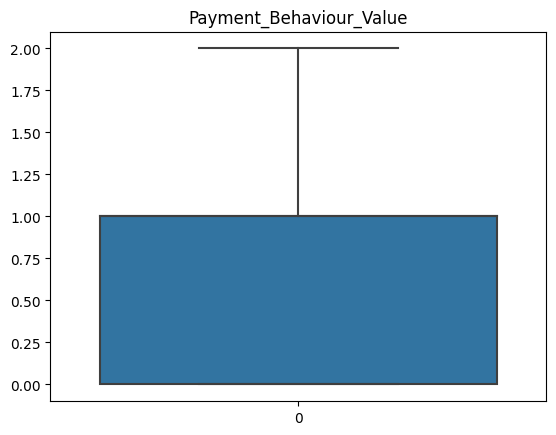

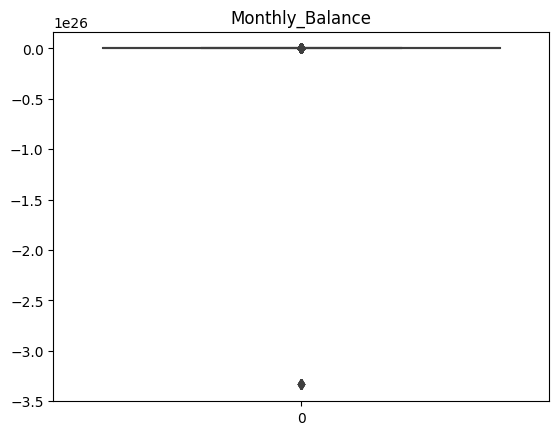

In [174]:
import matplotlib.pyplot as plt
import seaborn as sns

# select columns to check for outliers
cols_to_check = ['Credit_History_Age', 'Payment_of_Min_Amount', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Payment_Behaviour_Spent','Payment_Behaviour_Value', 'Monthly_Balance']

# create boxplots for each column
for col in cols_to_check:
    plt.figure()
    sns.boxplot(data=df_train[col])
    plt.title(col)


In [175]:
cols_to_check = ['Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance']
percentiles = [0.05, 0.95]
print(df_train[['Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance']].median())
df_train[cols_to_check].describe(percentiles=percentiles)

Total_EMI_per_month         69.249473
Amount_invested_monthly    136.173912
Monthly_Balance            337.252465
dtype: float64


,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,100000.000000,100000.000000,1.000000e+05
mean,1403.118217,617.257610,-3.000000e+22
std,8306.041270,1999.677146,3.162151e+24
min,0.000000,0.000000,-3.333333e+26
5%,0.000000,32.325419,1.748091e+02
50%,69.249473,136.173912,3.372525e+02
95%,437.012753,1060.347479,8.640757e+02
max,82331.000000,10000.000000,1.602041e+03


In [176]:
upper_lim = df_train['Amount_invested_monthly'].quantile(0.95)
df_train.loc[df_train['Amount_invested_monthly'] > upper_lim, 'Amount_invested_monthly'] = np.median(df_train['Amount_invested_monthly'])
upper_lim = df_train['Total_EMI_per_month'].quantile(0.95)
df_train.loc[df_train['Total_EMI_per_month'] > upper_lim, 'Total_EMI_per_month'] = np.median(df_train['Total_EMI_per_month'])

In [177]:
# Calculate median
median = np.median(df_train['Monthly_Balance'])

# Replace values outside 5-95 percentile range with median
p5 = np.percentile(df_train['Monthly_Balance'], 5)
p95 = np.percentile(df_train['Monthly_Balance'], 95)
df_train.loc[df_train['Monthly_Balance'] < p5, 'Monthly_Balance'] = median
df_train.loc[df_train['Monthly_Balance'] > p95, 'Monthly_Balance'] = median

In [178]:
print(df_train['Payment_of_Min_Amount'].median())
print(df_train['Payment_of_Min_Amount'].unique())
print(df_train.groupby('Payment_of_Min_Amount')['Credit_Score'].mean())
df_train['Payment_of_Min_Amount'].describe()


0.0
[2 1 0]
Payment_of_Min_Amount
0    1.640790
1    1.893979
2    2.249502
Name: Credit_Score, dtype: float64


count    100000.000000
mean          0.833410
std           0.923139
min           0.000000
25%           0.000000
50%           0.000000
75%           2.000000
max           2.000000
Name: Payment_of_Min_Amount, dtype: float64

In [179]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 31 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  float64
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     100000 non-null  float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  int64  
 13  Type_of_Loan              100000 non-null  ob

In [180]:

# Calculate the mean credit score for each occupation
occupation_mean_credit = df_train.groupby('Occupation')['Credit_Score'].mean()

# Sort the occupations by their mean credit score in ascending order
sorted_occupations = occupation_mean_credit.sort_values(ascending=True)
print(sorted_occupations)

# Create a dictionary to map each occupation to a number
occupation_dict = {occupation: i+1 for i, occupation in enumerate(sorted_occupations.index)}

# Add a new column to the dataframe to show the occupation number
df_train['Occupation Number'] = df_train['Occupation'].map(occupation_dict)

# Print the updated dataframe
print(df_train)

Occupation
Writer           1.839626
Mechanic         1.861718
Scientist        1.872331
Entrepreneur     1.872443
Accountant       1.876631
Engineer         1.879678
Teacher          1.880409
Unkown           1.881250
Developer        1.894666
Manager          1.896067
Lawyer           1.900507
Doctor           1.903083
Musician         1.903603
Architect        1.908637
Journalist       1.910692
Media_Manager    1.923238
Name: Credit_Score, dtype: float64
            ID Customer_ID     Month           Name   Age          SSN   
0       0x1602   CUS_0xd40   January  Aaron Maashoh  23.0  821-00-0265  \
1       0x1603   CUS_0xd40  February  Aaron Maashoh  23.0  821-00-0265   
2       0x1604   CUS_0xd40     March  Aaron Maashoh  23.0  821-00-0265   
3       0x1605   CUS_0xd40     April  Aaron Maashoh  23.0  821-00-0265   
4       0x1606   CUS_0xd40       May  Aaron Maashoh  23.0  821-00-0265   
...        ...         ...       ...            ...   ...          ...   
99995  0x25fe9  CUS_

In [181]:
df_train.groupby('Occupation Number')['Credit_Score'].mean()
df_train=df_train.drop('Name',axis=1)

df_train['Occupation']=df_train['Occupation Number']

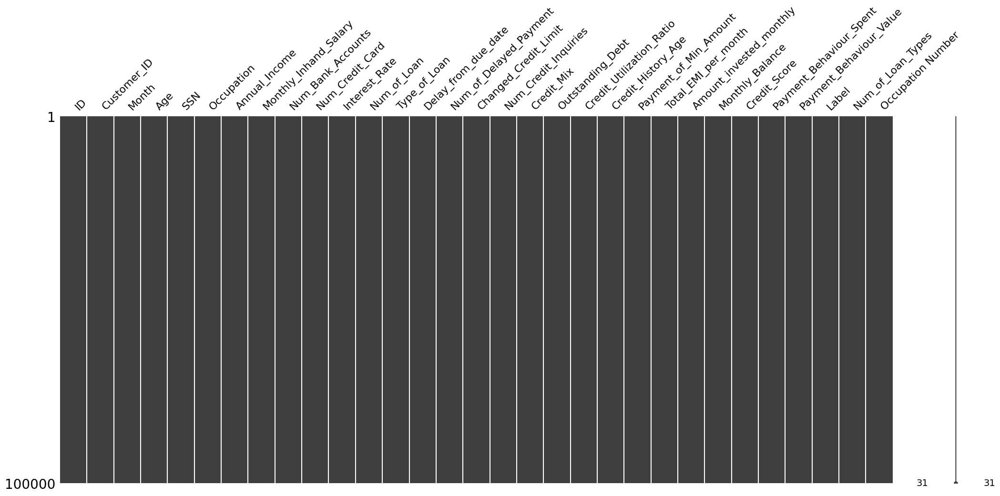

In [182]:
mnso.matrix(df_train)
plt.show()

In [183]:
df_train=df_train.drop('Customer_ID',axis=1)
df_train=df_train.drop('ID',axis=1)
df_train=df_train.drop('Month',axis=1)
# df_train=df_train.drop('Name',axis=1)
df_train=df_train.drop('SSN',axis=1)
df_train=df_train.drop('Occupation Number',axis=1)
df_train=df_train.drop('Label',axis=1)
df_train=df_train.drop('Num_of_Loan_Types',axis=1)
df_train=df_train.drop('Annual_Income',axis=1)
df_train=df_train.drop('Type_of_Loan',axis=1)

In [184]:
for column in df_train.columns:
    if df_train[column].dtype != object and (df_train[column] < 0).any():
        mean_value = df_train[column][df_train[column] >= 0].mean()
        df_train[column] = df_train[column].apply(lambda x: mean_value if x < 0 else x)


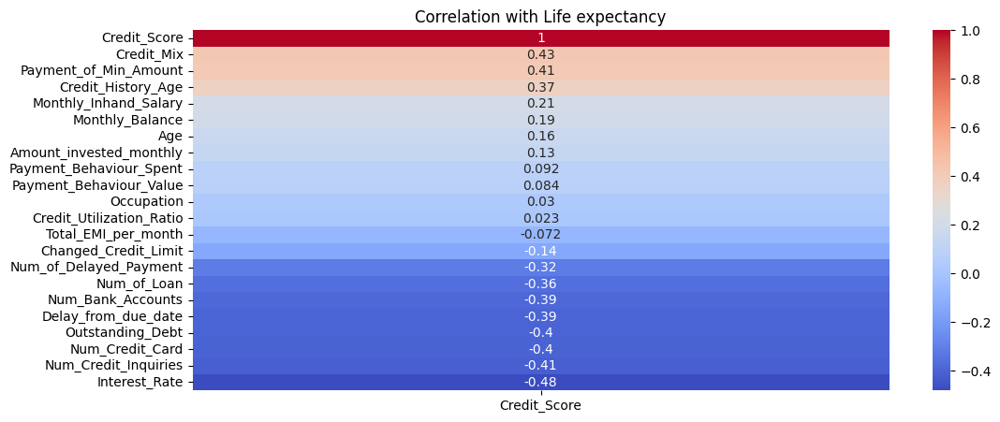

In [185]:
corr_df = df_train.corr()[['Credit_Score']].sort_values('Credit_Score', ascending=False)


fig, ax = plt.subplots(figsize=(12, 5))
sns.heatmap(corr_df, annot=True, cmap='coolwarm', ax=ax)
ax.set_title("Correlation with Life expectancy")
plt.show()

In [190]:
df_train.to_csv('v1_train.csv', index=False)
df_train=pd.read_csv('v1_train.csv')

In [191]:
df_train=df_train.drop('Payment_Behaviour_Spent',axis=1)
df_train=df_train.drop('Payment_Behaviour_Value',axis=1)
df_train=df_train.drop('Payment_of_Min_Amount',axis=1)
df_train=df_train.drop('Num_of_Loan',axis=1)

In [192]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 18 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Age                       100000 non-null  float64
 1   Occupation                100000 non-null  int64  
 2   Monthly_Inhand_Salary     100000 non-null  float64
 3   Num_Bank_Accounts         100000 non-null  float64
 4   Num_Credit_Card           100000 non-null  int64  
 5   Interest_Rate             100000 non-null  int64  
 6   Delay_from_due_date       100000 non-null  float64
 7   Num_of_Delayed_Payment    100000 non-null  float64
 8   Changed_Credit_Limit      100000 non-null  float64
 9   Num_Credit_Inquiries      100000 non-null  float64
 10  Credit_Mix                100000 non-null  int64  
 11  Outstanding_Debt          100000 non-null  float64
 12  Credit_Utilization_Ratio  100000 non-null  float64
 13  Credit_History_Age        100000 non-null  in

In [193]:
df_train.to_csv('v2_train.csv', index=False)